## Importing Libraries

In [1]:
import numpy as np
from matplotlib import image
import matplotlib.pyplot as plt
from scipy import signal
import cv2 
from tqdm import tqdm

## Loading texture

In [207]:
texture = cv2.imread('custom_texture_2.jpg').astype(np.float32)

In [43]:
texture.shape

(400, 600, 3)

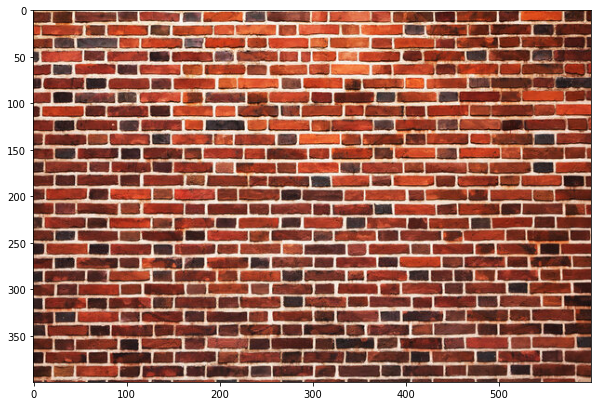

In [44]:
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB));

We start with the simplest method and as we move on, we try to enhance our method.

## Random Placement of blocks

<img src='report_images/random_placement_of_blocks.png'>

Basicly, sample blocks from texture and place it on the image. that's it!

This funciton return a random block from the given image

In [6]:
def get_random_block(im, size):
    i = np.random.randint(im.shape[0] - size)
    j = np.random.randint(im.shape[1] - size)
    return im[i:i+size, j:j+size]

In [45]:
windows_size = 100
result_shape = (2000, 2000, 3)

In [8]:
def random_placement(texture, windows_size, result_shape):
    result = np.zeros(result_shape, dtype=texture.dtype)

    num_blocks_i = np.ceil(result_shape[0] / windows_size).astype('int')
    num_blocks_j = np.ceil(result_shape[1] / windows_size).astype('int')
    for i in range(num_blocks_i):
        for j in range(num_blocks_j):
            i_start, j_start = i*windows_size, j*windows_size
            i_end, j_end = min((i+1)*windows_size, result_shape[0]), min((j+1)*windows_size, result_shape[1])
            result[i_start:i_end, j_start:j_end] = get_random_block(texture, windows_size)[:i_end-i_start, :j_end-j_start]
    return result

In [46]:
result = random_placement(texture, windows_size, result_shape)

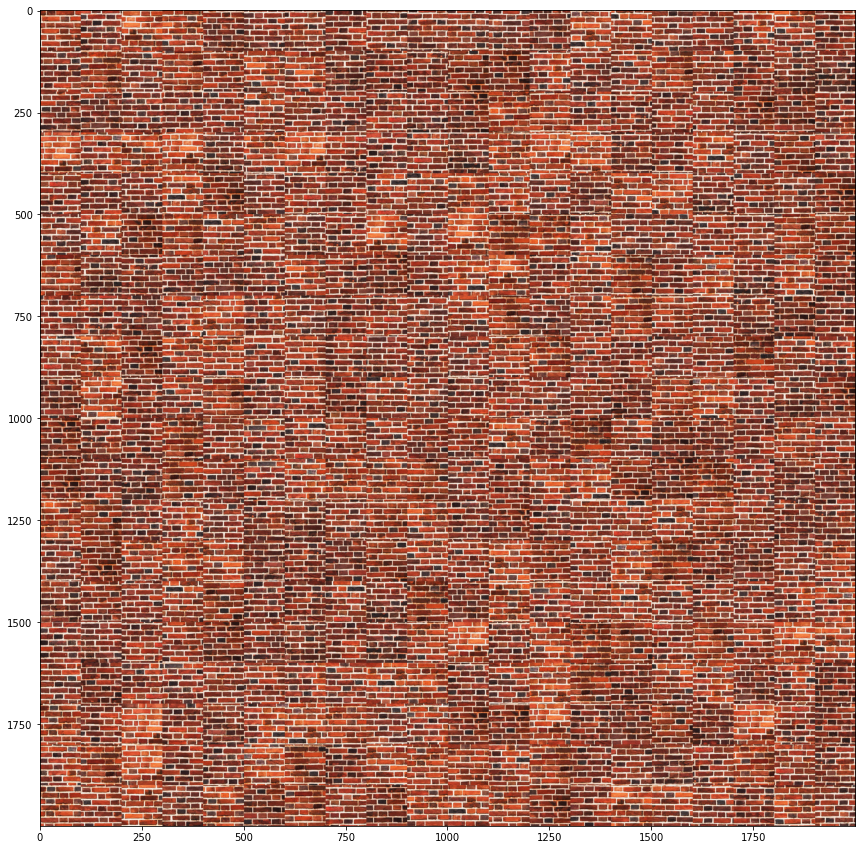

In [47]:
plt.figure(figsize=(15, 15))
plt.imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

If we take a close look at the picture above, we see that it is made up of squares which are not aligned. so our goal is to come up with an image that is perfectly aligned and squares are not noticable.

## Neighboring blocks constrained by overlap

<img src='report_images/neighboring_blocks.png'>

In this method, we pick a block from texture such that it is a best match for it's neighboring. for measuring the matching metric, we use L2 distance. Also a parameter `overlap` is defined which controls the boundry of the patch that overlaps with it's neighboring. This area takes into account for measuring distance between this patch and it's neighboring. 

L2 Distance: $\sum{(img-texture)^2}$

**Note**: Only on overlaps

In [11]:
def l2_dist(texture_block, im, i_range, j_range, overlap):
    dist = 0
    if j_range[0] > 0:
        dist += np.sum((texture_block[:, :overlap] - im[i_range[0]:i_range[1], j_range[0]:j_range[0]+overlap]) ** 2)
    if i_range[0] > 0:
        dist += np.sum((texture_block[:overlap, :] - im[i_range[0]:i_range[0]+overlap, j_range[0]:j_range[1]]) ** 2)
    if i_range[0] > 0 and j_range[0] > 0:
        dist -= np.sum((texture_block[:overlap, :overlap] - im[i_range[0]:i_range[0]+overlap, j_range[0]:j_range[0]+overlap]) ** 2)
    
    return dist

This functions searches for the best patch in texture image. After that, it choose a random patch among `N` best patches.

In [12]:
def find_best_l2_diff(texture, im, i_range, j_range, overlap, N=10):
    dist_arr = []
    coords_arr = []
    i_diff, j_diff = i_range[1]-i_range[0], j_range[1]-j_range[0]
    for i in range(texture.shape[0] - i_diff):
        for j in range(texture.shape[1] - j_diff):
            dist = l2_dist(texture[i:i+i_diff, j:j+j_diff], im, i_range, j_range, overlap)
            dist_arr.append(dist)
            coords_arr.append((i, j))
    idx = np.random.choice(np.argsort(dist_arr)[:N])
    i_s, j_s = coords_arr[idx]
    
    return texture[i_s:i_s+i_diff, j_s:j_s+j_diff]

In [13]:
def neighboring_blocks_constrained_by_overlap(texture, windows_size, result_shape, overlap):
    result = np.zeros(result_shape, dtype=texture.dtype)

    num_blocks_i = np.ceil((result_shape[0]-windows_size) / (windows_size-overlap)).astype('int') + 1
    num_blocks_j = np.ceil((result_shape[1]-windows_size) / (windows_size-overlap)).astype('int') + 1

    result[:windows_size, :windows_size] = get_random_block(texture, windows_size)
    for i in tqdm(range(num_blocks_i)):
        for j in range(num_blocks_j):
            if i == 0 and j == 0: 
                continue
            i_start, j_start = i*(windows_size-overlap), j*(windows_size-overlap)
            i_end = min(i_start + windows_size, result_shape[0])
            j_end = min(j_start + windows_size, result_shape[1])
            
            half_overlap_i = overlap//2 if i != 0 else 0
            half_overlap_j = overlap//2 if j != 0 else 0

            result[i_start+half_overlap_i:i_end, j_start+half_overlap_j:j_end] = find_best_l2_diff(
                texture, result, (i_start, i_end), (j_start, j_end), overlap
            )[half_overlap_i:, half_overlap_j:]
    
    return result

In [48]:
windows_size = 150
overlap = 20
result_shape = (550, 550, 3)

In [49]:
result = neighboring_blocks_constrained_by_overlap(texture, windows_size, result_shape, overlap)

100%|██████████| 5/5 [01:03<00:00, 12.60s/it]


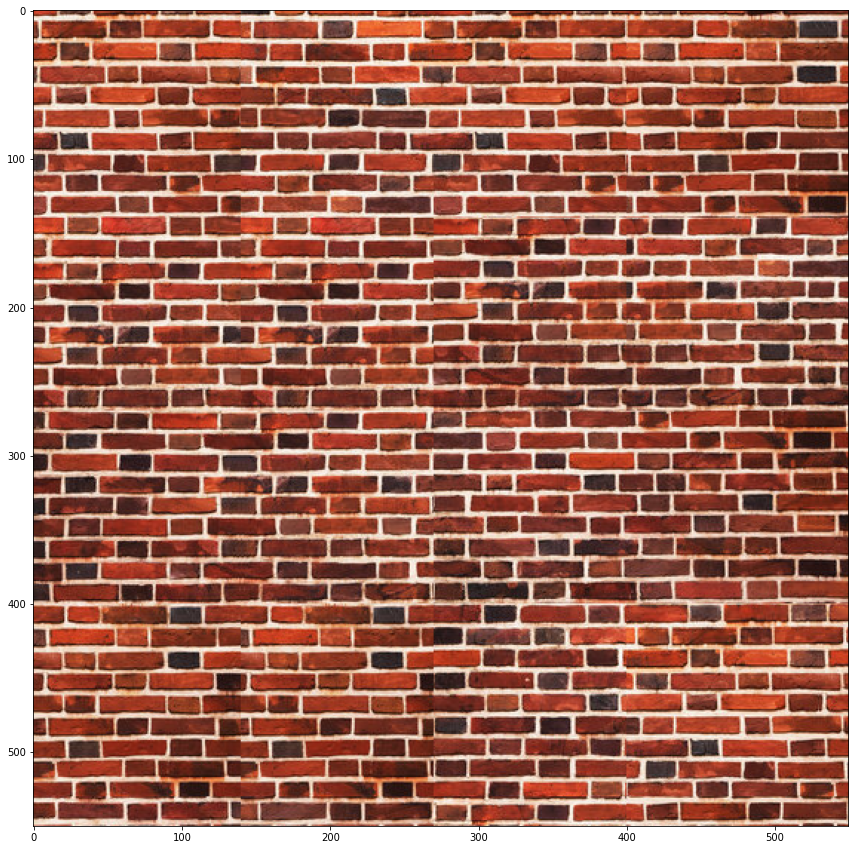

In [50]:
plt.figure(figsize=(15, 15))
plt.imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

We see that, it has improved a bit. But, there is of course room for enhancement. so let's try our final method.

## Minimal error boundry cut

<img src='report_images/minimal_error_boundry_cut.png'>

This method is same as before, but, after finding the patch, we find a boundry (as you can see in the image above) that if we cut the patch based on that, we'll get a better result. For example, in the image above, we use $B_1$ for the left hand side of the boundry, and $B_2$ for the right hand side of it.

We use dynamic programing to solve min cut path problem. You can see exactly how it works from the example below.

Basicly, In each step: when we are in a cell $(i, j)$, we have reached here from $(i-1, j-1)$, $(i, j-1)$, or $(i+1, j-1)$. We choose the one with the least cost.

In [19]:
def min_cut_path_mask(cost_arr):
    dp = np.zeros_like(cost_arr)
    directions = np.zeros_like(cost_arr, dtype=int) # 0: left-up, 1: left-middle, 2: left:down
    dp[:, 0] = cost_arr[:, 0]
    for j in range(1, cost_arr.shape[1]):
        for i in range(cost_arr.shape[0]):
            options = np.array([np.inf, dp[i, j-1], np.inf])
            if i > 0:
                options[0] = dp[i-1, j-1]
            if i < directions.shape[0]-1:
                options[2] = dp[i+1, j-1]
            directions[i, j] = np.argmin(options + cost_arr[i, j])
            dp[i, j] = dp[i+directions[i, j]-1, j-1] + cost_arr[i, j]
    mask = np.zeros_like(cost_arr, dtype=bool)
    tmp = (np.argmin(dp[:, -1]), directions.shape[1]-1)
    while tmp[1] >= 0:
        mask[tmp[0], tmp[1]] = True
        tmp = (tmp[0]+directions[tmp[0], tmp[1]]-1, tmp[1]-1)
    return mask

<img src='report_images/min_cut_path.png'>

In [20]:
test_arr = np.array([
    [1, 3, 4, 1],
    [2, 1, 2, 3],
    [4, 2, 1, 4],
])
test_res = min_cut_path_mask(test_arr)
test_res

array([[ True, False, False,  True],
       [False,  True,  True, False],
       [False, False, False, False]])

So, we see it works perfetly in this example.

In [21]:
def fill_above_with_true(mask):
    for j in range(mask.shape[1]):
        idx = np.where(mask[:, j])[0][0]
        mask[:idx, j] = True
    return mask

In [22]:
fill_above_with_true(test_res)

array([[ True,  True,  True,  True],
       [False,  True,  True, False],
       [False, False, False, False]])

This function just filles the upper part of the boundry. (We'll use this to create a mask)

For cutting the boundries of a patch, we detect the upper and the left boundires. Then we use these boundries to cut the patch.

In [23]:
def min_cut_block(txture_block, im, i_range, j_range, overlap):
    texture_block = txture_block.copy()
    mask = np.zeros(texture_block.shape[:2], dtype=bool)
    if i_range[0] > 0:
        cost = (texture_block[:overlap, :] - im[i_range[0]:i_range[0]+overlap, j_range[0]:j_range[1]])**2
        top_path = min_cut_path_mask(cost.sum(axis=2))
        top_path = fill_above_with_true(top_path)
        mask[:overlap, :] = top_path
    if j_range[0] > 0:
        cost = (texture_block[:, :overlap] - im[i_range[0]:i_range[1], j_range[0]:j_range[0]+overlap])**2
        left_path = fill_above_with_true(min_cut_path_mask(cost.sum(axis=2).T)).T
        mask[:, :overlap] = left_path

    texture_block[mask] = im[i_range[0]:i_range[1], j_range[0]:j_range[1]][mask]
    
    return texture_block

As we mentioned earlier, we first find the best patch like the previous method. Then we use min cut.

In [24]:
def minimal_error_boundry_cut(texture, windows_size, result_shape, overlap):
    result = np.zeros(result_shape, dtype=texture.dtype)

    num_blocks_i = np.ceil((result_shape[0]-windows_size) / (windows_size-overlap)).astype('int') + 1
    num_blocks_j = np.ceil((result_shape[1]-windows_size) / (windows_size-overlap)).astype('int') + 1

    result[:windows_size, :windows_size] = get_random_block(texture, windows_size)
    for i in tqdm(range(num_blocks_i)):
        for j in range(num_blocks_j):
            if i == 0 and j == 0: 
                continue
            i_start, j_start = i*(windows_size-overlap), j*(windows_size-overlap)
            i_end = min(i_start + windows_size, result_shape[0])
            j_end = min(j_start + windows_size, result_shape[1])

            texture_block = find_best_l2_diff(texture, result, (i_start, i_end), (j_start, j_end), overlap)
            fixed_cut_block = min_cut_block(texture_block, result, (i_start, i_end), (j_start, j_end), overlap)
            result[i_start:i_end, j_start:j_end] = fixed_cut_block
    
    return result

In [208]:
windows_size = 150
overlap = 25
result_shape = (550, 550, 3)

In [210]:
result = minimal_error_boundry_cut(texture, windows_size, result_shape, overlap)

100%|██████████| 5/5 [01:08<00:00, 13.76s/it]


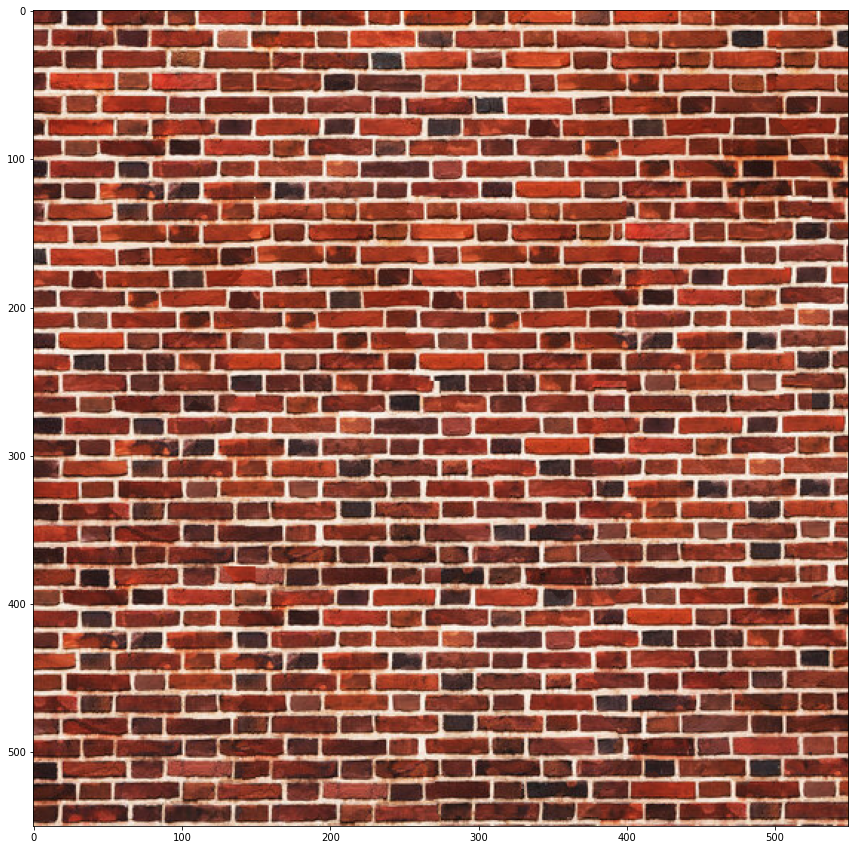

In [92]:
plt.figure(figsize=(15, 15))
plt.imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

We see that it has enhanced alot. But, as you might have noticed it, we have problems with time complexity. In order to enhance it, we use pyramid technique.

## Pyramid

Downsampling functions

In [28]:
def downsample(im, factor=2):
    return im[::factor, ::factor]
    
def downsample_point(p, factor=2):
    return (p[0]//factor, p[1]//factor)

This is like the previous `find_best_l2_diff` functtion, but, it returns the coordinates of the match instead of the actual texture.

In [198]:
def find_best_l2_diff_coords(texture, im, i_range, j_range, overlap, randomize=False, N=10):
    dist_arr = []
    coords_arr = []
    i_diff, j_diff = i_range[1]-i_range[0], j_range[1]-j_range[0]
    for i in range(texture.shape[0] - i_diff):
        for j in range(texture.shape[1] - j_diff):
            dist = l2_dist(texture[i:i+i_diff, j:j+j_diff], im, i_range, j_range, overlap)
            dist_arr.append(dist)
            coords_arr.append((i, j))
    if randomize:
        idx = np.random.choice(np.argsort(dist_arr)[:N])
    else:
        idx = np.argmin(dist_arr)
    i_s, j_s = coords_arr[idx]
    
    return (i_s, i_s+i_diff), (j_s, j_s+j_diff)

This function just expands the search area (by adding margin to it's boundries)

In [191]:
def expand_search_coords_area(coord1, coord2, search_boundry, im):
    new_coord1 = max(0, coord1[0]-search_boundry), min(im.shape[0], coord1[1]+search_boundry)
    new_coord2 = max(0, coord2[0]-search_boundry), min(im.shape[1], coord2[1]+search_boundry)

    return new_coord1, new_coord2

In [193]:
def add_coords(coord1, coord2):
    return (coord1[0]+coord2[0], coord1[1]+coord2[1])

def add_const_to_coords(coord, const):
    return (coord[0]+const, coord[1]+const)

In this function: at the lowest level, we find a match in downsampled texture. At the upper level, we search for a better match in the upsampled version of the previous one. This search is controlled by the parameter `search_boundry` 

In [199]:
def pyramid_search(level, search_boundry, texture, im, i_range, j_range, overlap):
    if level == 1:
        return find_best_l2_diff_coords(texture, im, i_range, j_range, overlap, randomize=False)
    
    coords = pyramid_search(level-1, search_boundry, downsample(texture), downsample(im), downsample_point(i_range), downsample_point(j_range), overlap//2)
    coords = add_coords(coords[0], coords[0]), add_coords(coords[1], coords[1])
    search_coords = expand_search_coords_area(coords[0], coords[1], search_boundry, texture)
    new_coords = find_best_l2_diff_coords(
        texture[search_coords[0][0]:search_coords[0][1], search_coords[1][0]:search_coords[1][1]],
        im, i_range, j_range, overlap
    )
    new_coords = add_const_to_coords(new_coords[0], search_coords[0][0]), add_const_to_coords(new_coords[1], search_coords[1][0])
    return new_coords

In [195]:
def make_texture_by_pyramid(texture, windows_size, result_shape, overlap):
    result = np.zeros(result_shape, dtype=texture.dtype)

    num_blocks_i = np.ceil((result_shape[0]-windows_size) / (windows_size-overlap)).astype('int') + 1
    num_blocks_j = np.ceil((result_shape[1]-windows_size) / (windows_size-overlap)).astype('int') + 1

    result[:windows_size, :windows_size] = get_random_block(texture, windows_size)
    for i in tqdm(range(num_blocks_i)):
        for j in range(num_blocks_j):
            if i == 0 and j == 0: 
                continue
            i_start, j_start = i*(windows_size-overlap), j*(windows_size-overlap)
            i_end = min(i_start + windows_size, result_shape[0])
            j_end = min(j_start + windows_size, result_shape[1])

            coords = pyramid_search(3, 10, texture, result, (i_start, i_end), (j_start, j_end), overlap)
            texture_block = texture[coords[0][0]:coords[0][1], coords[1][0]:coords[1][1]]
            fixed_cut_block = min_cut_block(texture_block, result, (i_start, i_end), (j_start, j_end), overlap)
            result[i_start:i_end, j_start:j_end] = fixed_cut_block
    
    return result

In [211]:
windows_size = 150
overlap = 30
result_shape = (2500, 2500, 3)

In [212]:
result = make_texture_by_pyramid(texture, windows_size, result_shape, overlap)

100%|██████████| 21/21 [01:25<00:00,  4.09s/it]


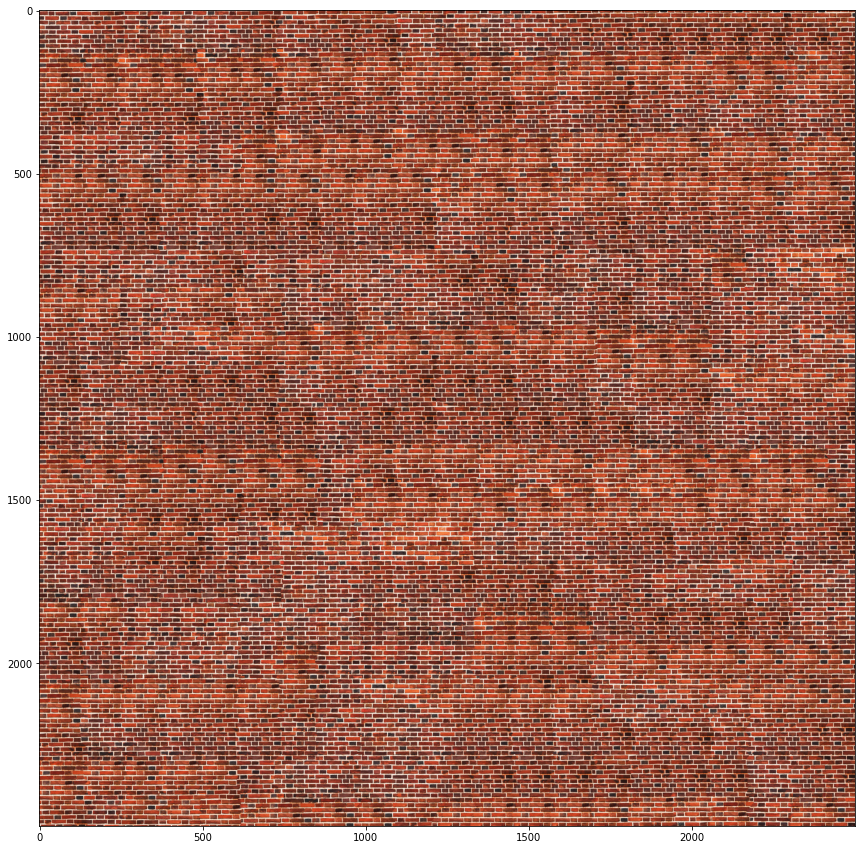

In [213]:
plt.figure(figsize=(15, 15))
plt.imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

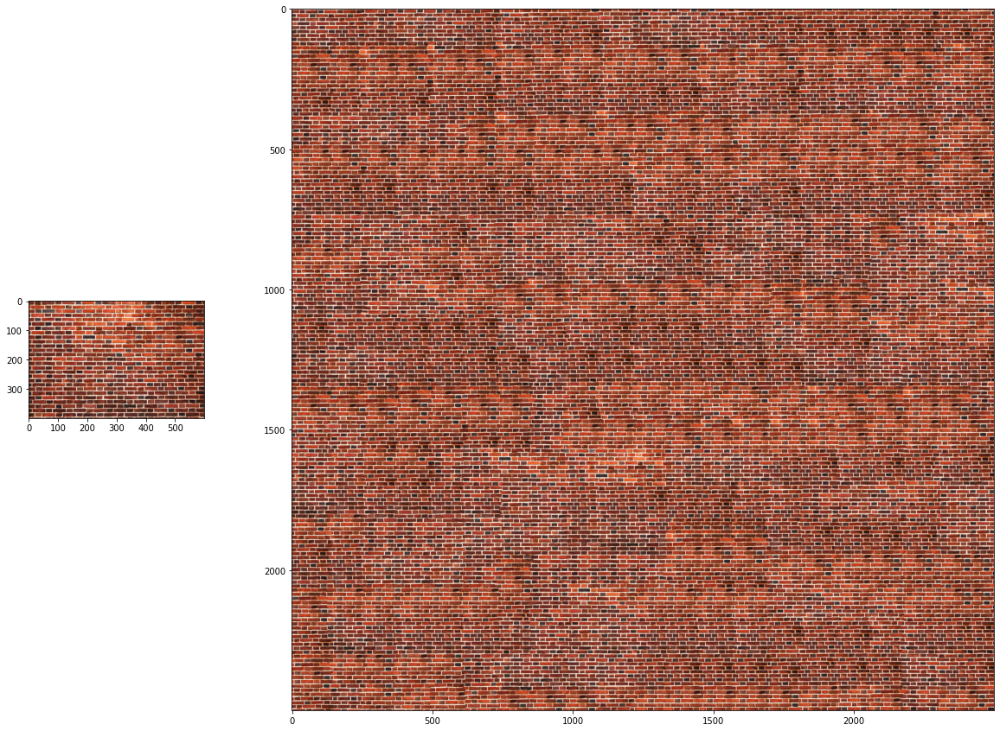

In [214]:
_, axs = plt.subplots(1, 2, figsize=(20, 15), gridspec_kw={'width_ratios': [1, 4]})
axs[0].imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB))
axs[1].imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

## Testing on other textures

100%|██████████| 50/50 [02:00<00:00,  2.41s/it]


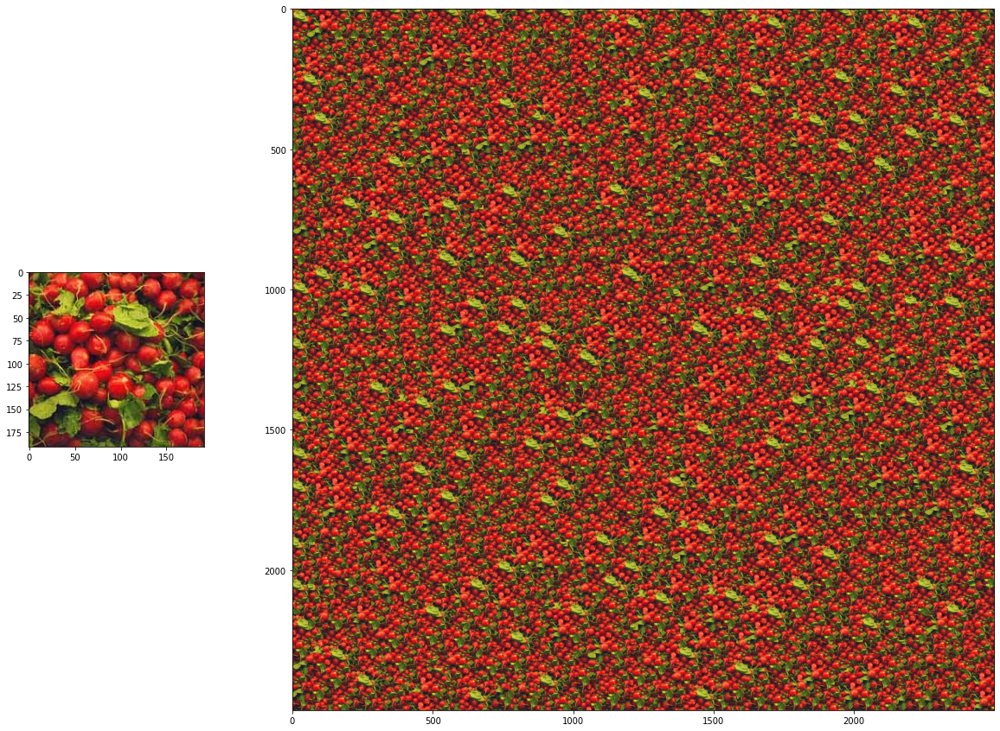

In [202]:
texture = cv2.imread('custom_texture_1.jpg').astype(np.float32)
result = make_texture_by_pyramid(texture, windows_size=80, result_shape=(2500, 2500, 3), overlap=30)

_, axs = plt.subplots(1, 2, figsize=(20, 15), gridspec_kw={'width_ratios': [1, 4]})
axs[0].imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB))
axs[1].imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

100%|██████████| 25/25 [00:31<00:00,  1.24s/it]


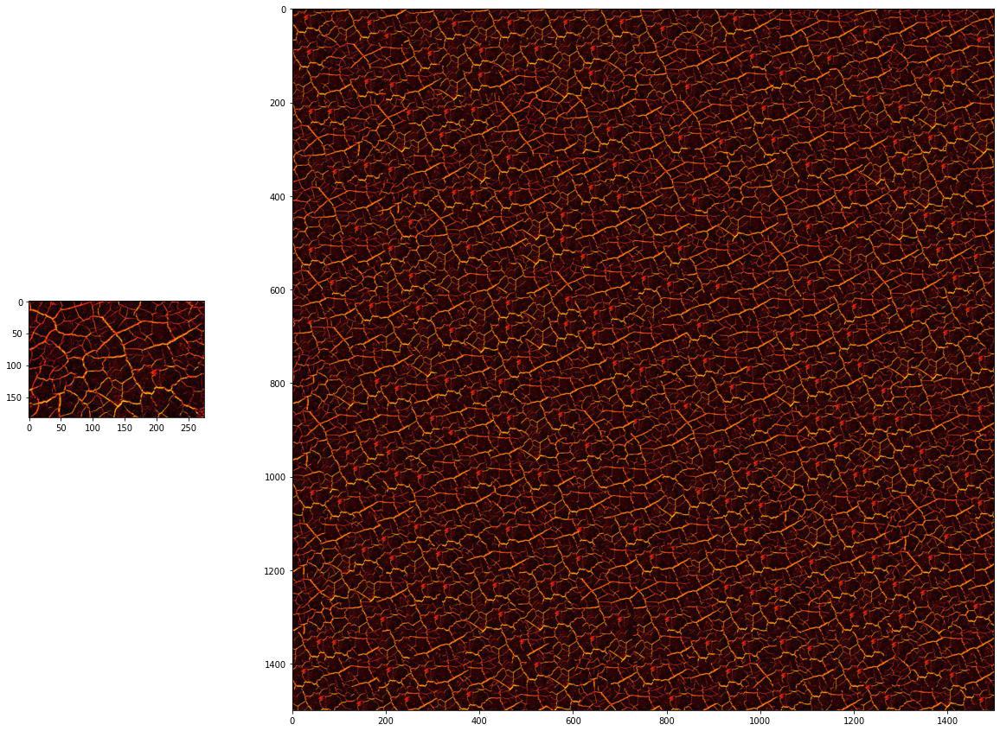

In [220]:
texture = cv2.imread('custom_texture_3.jpeg').astype(np.float32)
result = make_texture_by_pyramid(texture, windows_size=80, result_shape=(1500, 1500, 3), overlap=20)

_, axs = plt.subplots(1, 2, figsize=(20, 15), gridspec_kw={'width_ratios': [1, 4]})
axs[0].imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB))
axs[1].imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

100%|██████████| 16/16 [02:16<00:00,  8.56s/it]


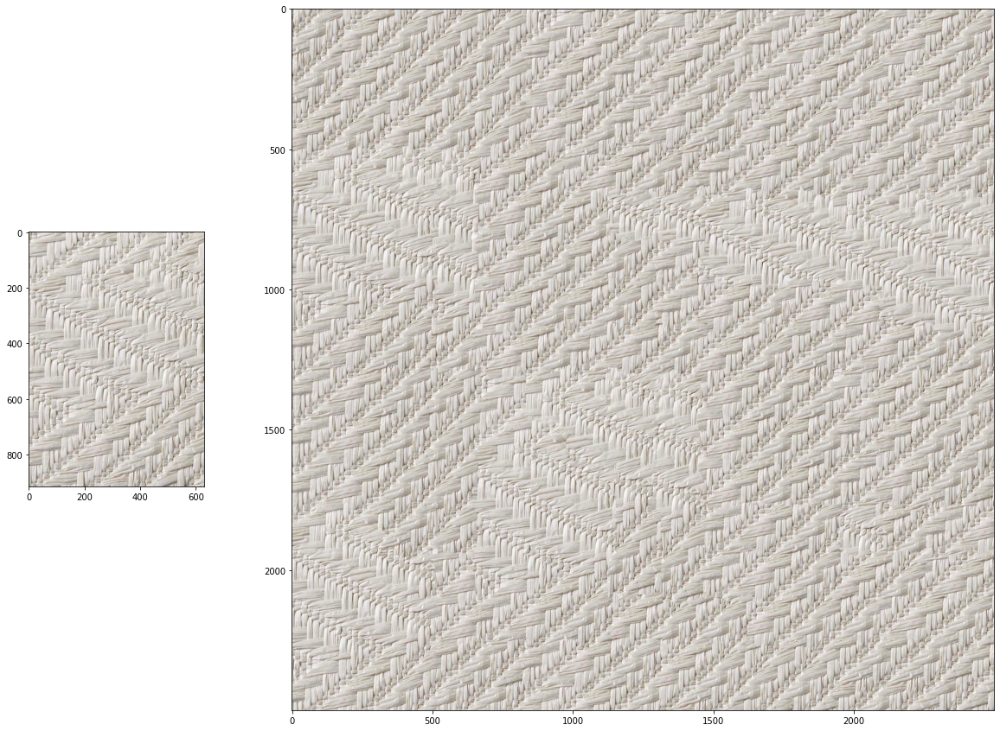

In [201]:
texture = cv2.imread('Textures/texture02.png').astype(np.float32)
result = make_texture_by_pyramid(texture, windows_size=200, result_shape=(2500, 2500, 3), overlap=40)

_, axs = plt.subplots(1, 2, figsize=(20, 15), gridspec_kw={'width_ratios': [1, 4]})
axs[0].imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB))
axs[1].imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

100%|██████████| 16/16 [00:49<00:00,  3.10s/it]


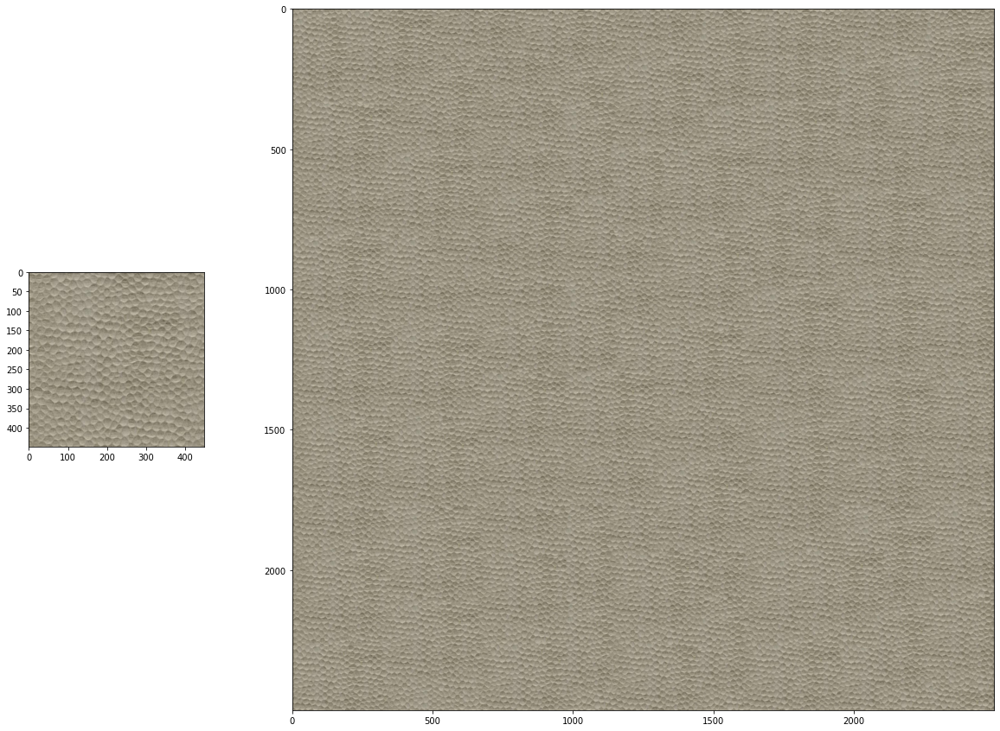

In [145]:
texture = cv2.imread('Textures/texture03.jpg').astype(np.float32)
result = make_texture_by_pyramid(texture, windows_size=200, result_shape=(2500, 2500, 3), overlap=40)

_, axs = plt.subplots(1, 2, figsize=(20, 15), gridspec_kw={'width_ratios': [1, 4]})
axs[0].imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB))
axs[1].imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

100%|██████████| 36/36 [03:53<00:00,  6.48s/it]


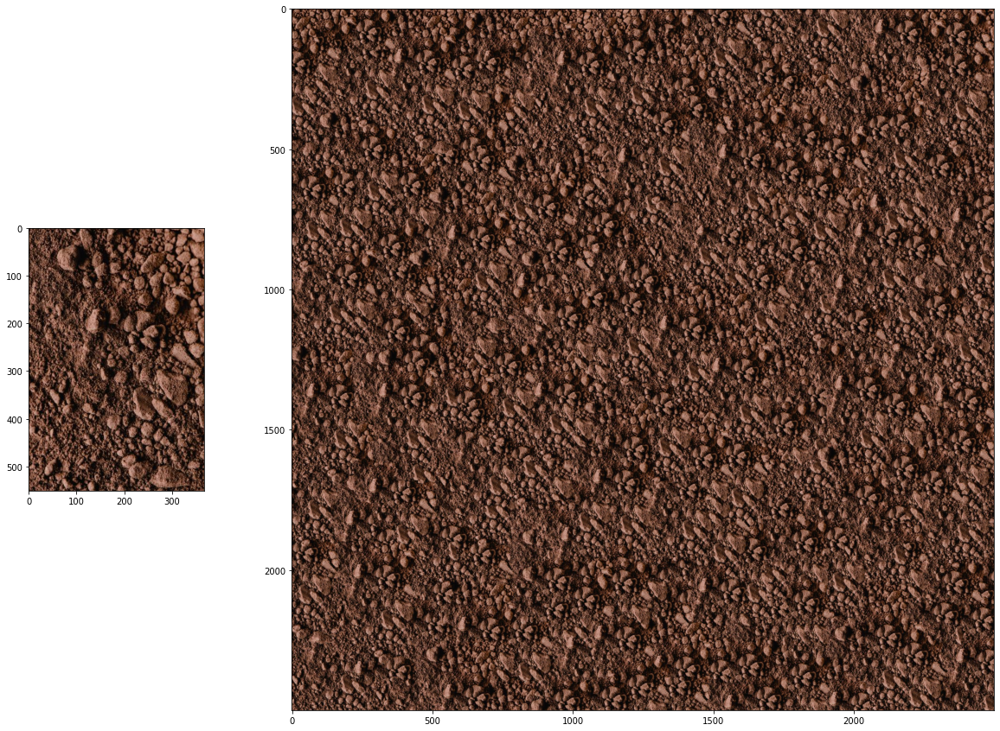

In [150]:
texture = cv2.imread('Textures/texture06.jpg').astype(np.float32)
result = make_texture_by_pyramid(texture, windows_size=100, result_shape=(2500, 2500, 3), overlap=30)

_, axs = plt.subplots(1, 2, figsize=(20, 15), gridspec_kw={'width_ratios': [1, 4]})
axs[0].imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB))
axs[1].imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

100%|██████████| 16/16 [01:55<00:00,  7.23s/it]


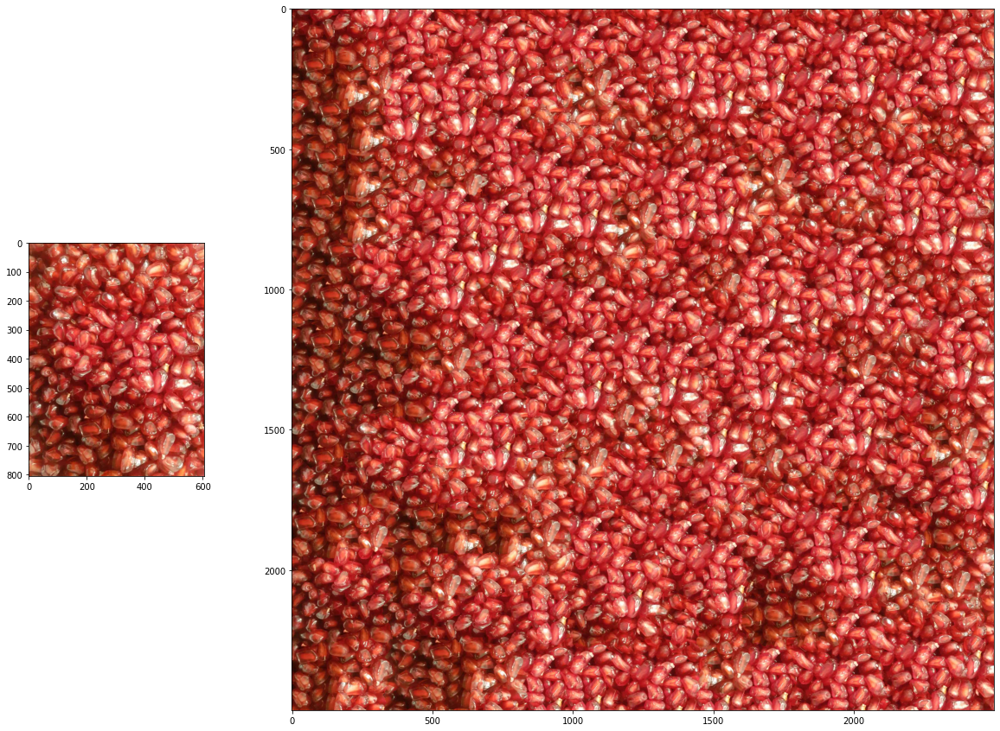

In [152]:
texture = cv2.imread('Textures/texture01.jpg').astype(np.float32)
result = make_texture_by_pyramid(texture, windows_size=200, result_shape=(2500, 2500, 3), overlap=40)

_, axs = plt.subplots(1, 2, figsize=(20, 15), gridspec_kw={'width_ratios': [1, 4]})
axs[0].imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB))
axs[1].imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

100%|██████████| 10/10 [00:10<00:00,  1.01s/it]


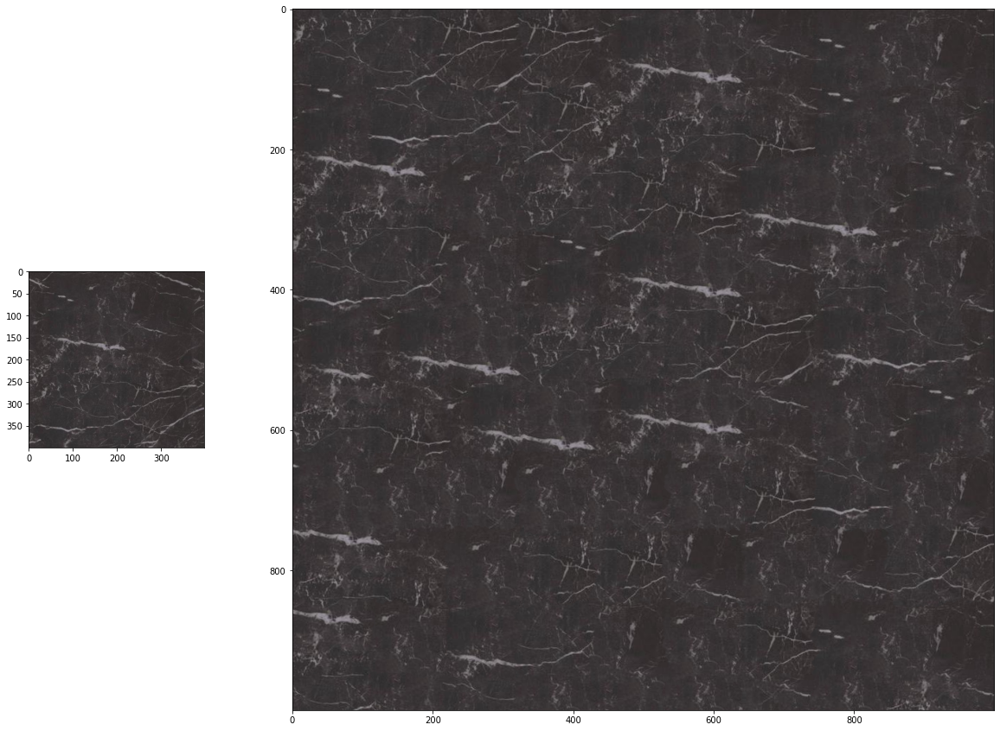

In [179]:
texture = cv2.imread('Textures/texture09.jpg').astype(np.float32)
result = make_texture_by_pyramid(texture, windows_size=120, result_shape=(1000, 1000, 3), overlap=15)

_, axs = plt.subplots(1, 2, figsize=(20, 15), gridspec_kw={'width_ratios': [1, 4]})
axs[0].imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB))
axs[1].imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

100%|██████████| 16/16 [01:19<00:00,  4.99s/it]


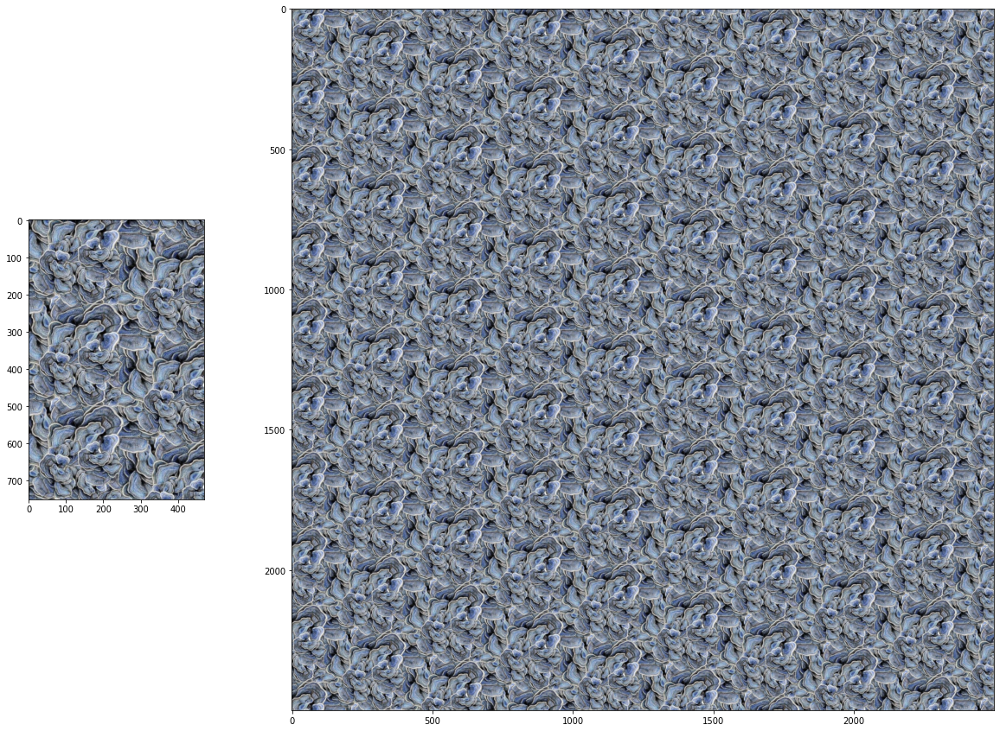

In [183]:
texture = cv2.imread('Textures/texture11.jpeg').astype(np.float32)
result = make_texture_by_pyramid(texture, windows_size=200, result_shape=(2500, 2500, 3), overlap=40)

_, axs = plt.subplots(1, 2, figsize=(20, 15), gridspec_kw={'width_ratios': [1, 4]})
axs[0].imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB))
axs[1].imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));

100%|██████████| 10/10 [00:17<00:00,  1.73s/it]


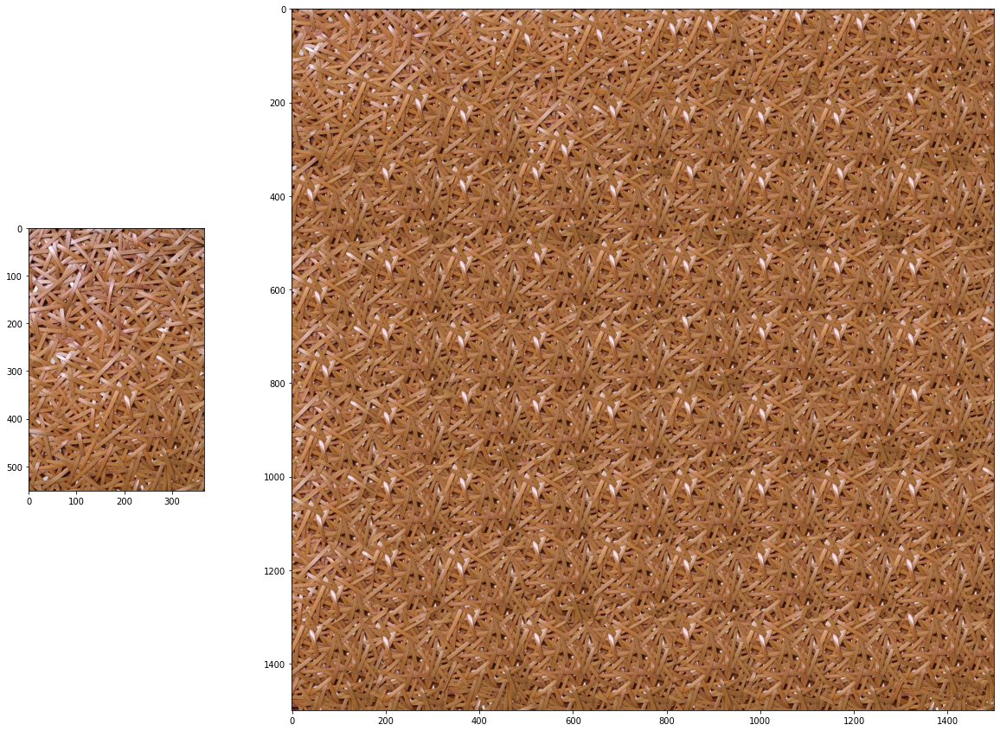

In [200]:
texture = cv2.imread('Textures/texture12.jpg').astype(np.float32)
result = make_texture_by_pyramid(texture, windows_size=200, result_shape=(1500, 1500, 3), overlap=40)

_, axs = plt.subplots(1, 2, figsize=(20, 15), gridspec_kw={'width_ratios': [1, 4]})
axs[0].imshow(cv2.cvtColor(texture.astype(np.uint8), cv2.COLOR_BGR2RGB))
axs[1].imshow(cv2.cvtColor(result.astype(np.uint8), cv2.COLOR_BGR2RGB));